<a href="https://colab.research.google.com/github/mano491/Emissions/blob/main/Ship_detection_MS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Before Running the Script Please Make Sure you Select the Run Time as GPU

> Add blockquote

> Add blockquote





#**Import the Required Libraries**

In [ ]:
from IPython.display import Image

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#**Clone the Github Repo**

In [ ]:

%cd /content/drive/MyDrive/Colab_Notebooks/ship_6classes

/content/drive/MyDrive/Colab_Notebooks/ship_6classes


In [ ]:
!git clone https://github.com/MuhammadMoinFaisal/YOLOv8-DeepSORT-Object-Tracking.git

fatal: destination path 'YOLOv8-DeepSORT-Object-Tracking' already exists and is not an empty directory.


In [ ]:
!pwd

/content/drive/MyDrive/Colab_Notebooks/ship_6classes


##Setting the Current Directory

In [ ]:
%cd /content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking


##Install all the Dependencies

In [ ]:
!pip install -e '.[dev]'

Obtaining file:///content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.7/231.7 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 44.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.wh

##Moving to the Required Directory

In [ ]:
%cd /content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [ ]:
!pwd

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


##Importing the Dataset from the RoboFlow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="p13Oy1JbwyOvCBsOy5VC")
project = rf.workspace("convert-g59qi").project("fastrcnn-update")
version = project.version(1)
dataset = version.download("yolov5")



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 7.7 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.7
    Uninstalling idna-3.7:
      Successfully uninstalled idna-3.7
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uninstalled cycler-0.12

loading Roboflow workspace...
loading Roboflow project...


##To implement the DeepSORT tracking, downloading the required files

In [ ]:
!gdown "https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t
To: /content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/deep_sort_pytorch.zip
100% 43.1M/43.1M [00:01<00:00, 27.7MB/s]


##Unzipping the DeepSORT Files

In [ ]:
!unzip 'deep_sort_pytorch.zip'

Archive:  deep_sort_pytorch.zip
replace deep_sort_pytorch/.gitignore? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

#**Training the Custom Model**

In [ ]:
#HOME = '/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect'
HOME = '/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect'

In [ ]:
%cd {HOME}

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [ ]:
%cd {dataset.location}

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/FastRCNN-Update-1


In [ ]:
%cd {HOME}

!python train.py model=yolov8l.pt data={dataset.location}/data.yaml epochs=30 imgsz=640

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect
yolo/engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/FastRCNN-Update-1/data.yaml, epochs=30, patience=50, batch=16, imgsz=640, save=True, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=False, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, retina_masks=Fals

In [ ]:
import os
import shutil

# Define the path to the current notebook and the destination folder in your Drive
source_path = '/content/YOLOv8-DeepSORT-Object-Tracking' # Adjust this path
destination_path = '/content/drive/MyDrive/Colab Notebooks/ship_6classes' # Adjust this path
if not os.path.exists(destination_path):
    os.makedirs(destination_path)
# Move the file
shutil.move(source_path, destination_path)

'/content/drive/MyDrive/Colab Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking'

In [ ]:
%cd /content/drive/MyDrive/Colab Notebooks/ship_6classes

/content/drive/MyDrive/Colab Notebooks/ship_6classes


#**Checking the Files inside the Train Folder**

In [ ]:
!pwd

/content/drive/MyDrive/Colab Notebooks/ship_6classes


In [ ]:
home1 = '/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train'

dataloc = ''

In [ ]:
%cd {home1}

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train


In [ ]:
!ls /content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train

args.yaml					    results.csv		  val_batch0_labels.jpg
confusion_matrix.png				    results.png		  val_batch0_pred.jpg
events.out.tfevents.1712030200.0814f792ef84.3796.0  train_batch0.jpg	  val_batch1_labels.jpg
F1_curve.png					    train_batch15120.jpg  val_batch1_pred.jpg
P_curve.png					    train_batch15121.jpg  val_batch2_labels.jpg
PR_curve.png					    train_batch15122.jpg  val_batch2_pred.jpg
predictions.json				    train_batch1.jpg	  weights
R_curve.png					    train_batch2.jpg


#**Printing the Confusion Matrix**

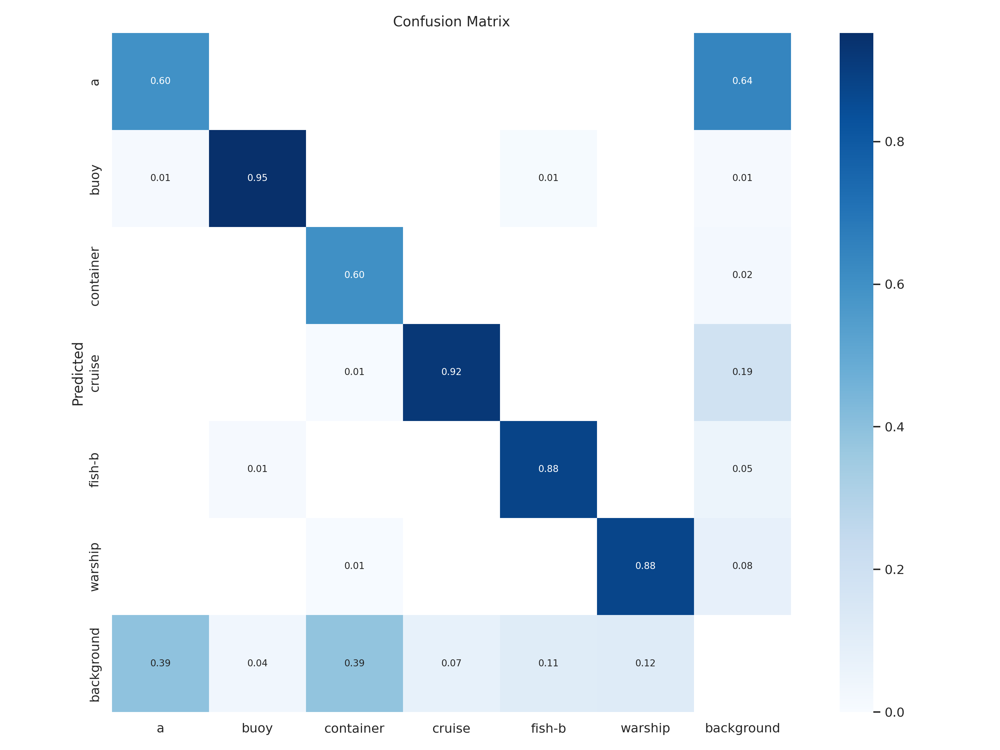

In [ ]:
Image(filename = home1+ '/confusion_matrix.png')

#**Printing the Training and the Validation Loss**

In [ ]:
import os

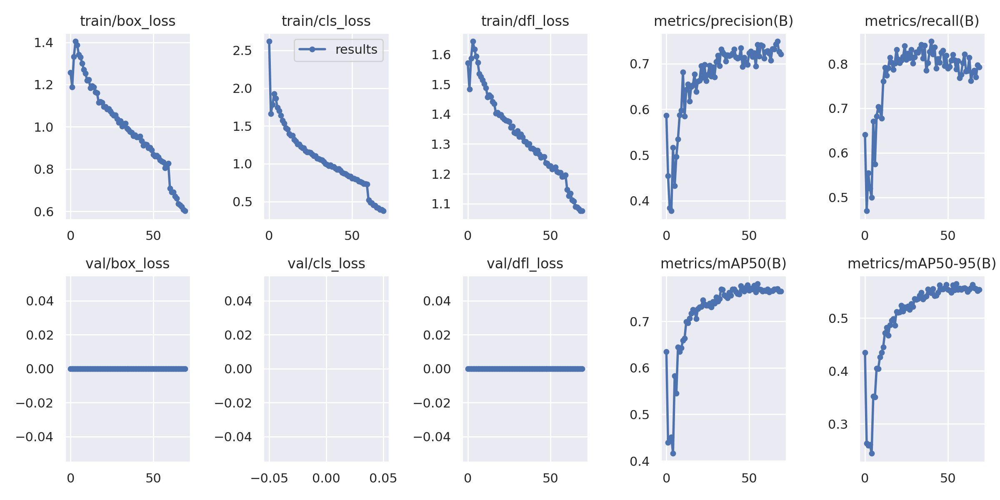

In [ ]:
Image(filename = os.path.join(home1, 'results.png'), width = 600)

#**Printing the Model Prediction on Validation Batch**

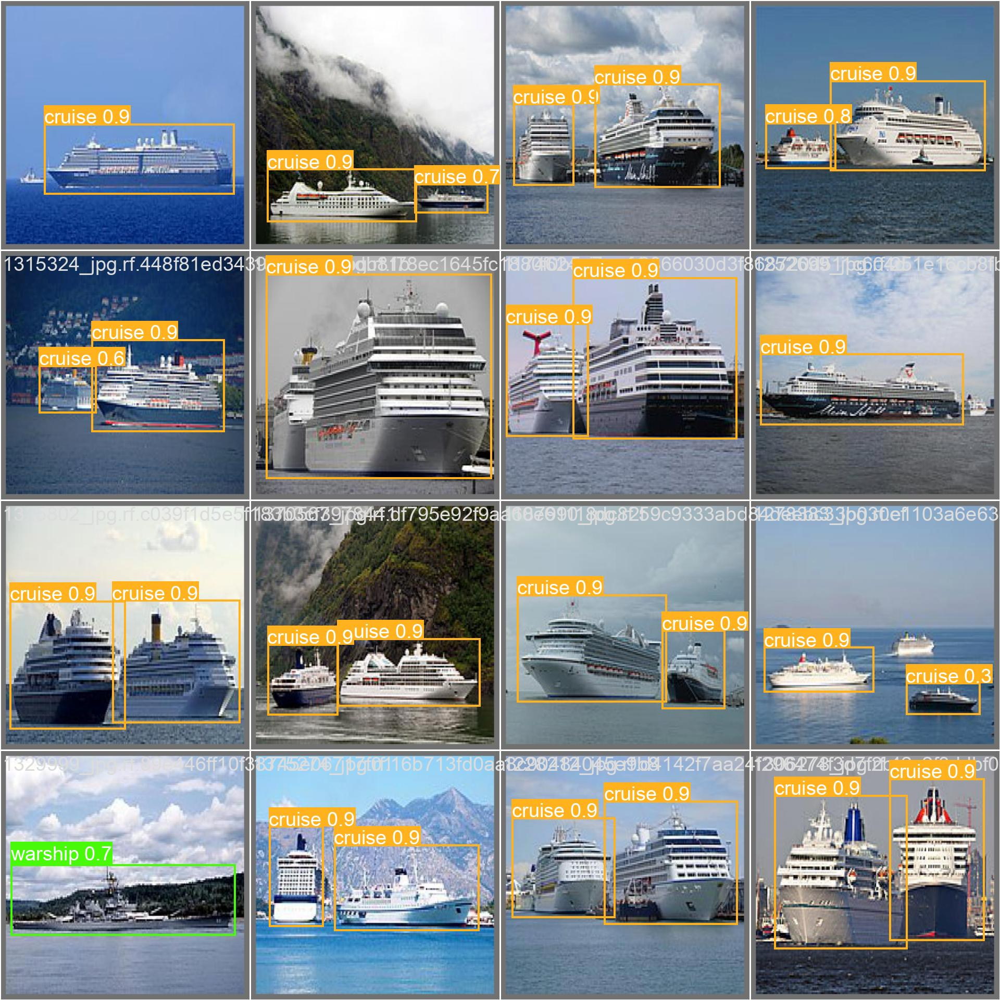

In [ ]:
Image(filename = r'/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train/val_batch1_pred.jpg', width =600)

#**Validate Custom Model**

In [ ]:
!pwd

/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train


In [ ]:
%cd /content/drive/MyDrive/Colab_Notebooks/ship_6classes1/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect

/content/drive/MyDrive/Colab_Notebooks/ship_6classes1/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [ ]:
!python val.py model= home1+'/content/drive/MyDrive/Colab_Notebooks/ship_6classes/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train/weights/best.pt' data={dataset.location}/data.yaml

mismatched input '+' expecting EQUAL
See https://hydra.cc/docs/1.2/advanced/override_grammar/basic for details

Set the environment variable HYDRA_FULL_ERROR=1 for a complete stack trace.


#**Inference with Custom Model**

#**Demo Video 1**

In [ ]:
!gdown "https://drive.google.com/uc?id=1EBUbK-6zqO3D5UBt-c0O6vSCP2mi09CD&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1EBUbK-6zqO3D5UBt-c0O6vSCP2mi09CD&confirm=t
To: /content/drive/MyDrive/Colab_Notebooks/ship_6classes1/videodemo.mp4
100% 48.9M/48.9M [00:00<00:00, 119MB/s]


In [ ]:
!pwd

/content/drive/MyDrive/Colab_Notebooks/ship_6classes1


In [ ]:
!python predict.py model='/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train/weights/best.pt' source='/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/videodemo.mp4'

python3: can't open file '/content/drive/MyDrive/Colab_Notebooks/ship_6classes1/predict.py': [Errno 2] No such file or directory


#**Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train15/videodemo.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Demo Video 2**

In [ ]:
!gdown "https://drive.google.com/uc?id=18tilBPwElyNGT9kMn_F7Z2X8ugh_Ra4l&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=18tilBPwElyNGT9kMn_F7Z2X8ugh_Ra4l&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/videodemo5.mp4
100% 11.9M/11.9M [00:00<00:00, 103MB/s] 


In [ ]:
!python predict.py model='/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train/weights/best.pt' source='videodemo5.mp4'

[2024-03-01 16:17:53,262][root.tracker][INFO] - Loading weights from deep_sort_pytorch/deep_sort/deep/checkpoint/ckpt.t7... Done!
2024-03-01 16:17:53.627205: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-01 16:17:53.627256: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-01 16:17:53.628654: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-01 16:17:54.750332: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.3 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Fusing layers

#**Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/YOLOv8-DeepSORT-Object-Tracking/runs/detect/train16/videodemo5.mp4'

# Compressed video path
compressed_path = "/content/result_compressed1.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)